In [1]:
import pandas as pd # dataframe manipulation
import numpy as np # linear algebra

# data visualization
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
import shap

# sklearn 
from sklearn.cluster import KMeans
from sklearn.preprocessing import PowerTransformer, OrdinalEncoder
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_score, silhouette_samples, accuracy_score, classification_report

from pyod.models.ecod import ECOD
from yellowbrick.cluster import KElbowVisualizer

import lightgbm as lgb
import prince

from kmodes.kprototypes import KPrototypes
from plotnine import *
import plotnine

IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html


In [2]:
df = pd.read_csv(r"C:\Users\hp\Clustering-with-LLM\data\data\train.csv", sep = ";")
df = df.iloc[:, 0:8]

In [3]:
df

,age,job,marital,education,default,balance,housing,loan
0,58,management,married,tertiary,no,2143,yes,no
1,44,technician,single,secondary,no,29,yes,no
2,33,entrepreneur,married,secondary,no,2,yes,yes
3,47,blue-collar,married,unknown,no,1506,yes,no
4,33,unknown,single,unknown,no,1,no,no
...,...,...,...,...,...,...,...,...
45206,51,technician,married,tertiary,no,825,no,no
45207,71,retired,divorced,primary,no,1729,no,no
45208,72,retired,married,secondary,no,5715,no,no
45209,57,blue-collar,married,secondary,no,668,no,no


In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 9 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   age        45211 non-null  int64 
 1   job        45211 non-null  object
 2   marital    45211 non-null  object
 3   education  45211 non-null  object
 4   default    45211 non-null  object
 5   balance    45211 non-null  int64 
 6   housing    45211 non-null  object
 7   loan       45211 non-null  object
 8   outliers   45211 non-null  int32 
dtypes: int32(1), int64(2), object(6)
memory usage: 2.9+ MB


<h1> Preprocessing </h1>

In [4]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OrdinalEncoder


pipe = Pipeline([('ordinal', OrdinalEncoder()), ('scaler', PowerTransformer())])
pipe_fit = pipe.fit(df)

data = pd.DataFrame(pipe_fit.transform(df), columns = df.columns)
data

,age,job,marital,education,default,balance,housing,loan
0,1.469546,0.093094,-0.286301,1.029751,-0.13549,0.996466,0.893915,-0.436803
1,0.417051,1.277591,1.379481,-0.254415,-0.13549,-0.775508,0.893915,-0.436803
2,-0.693452,-0.579713,-0.286301,-0.254415,-0.13549,-0.818578,0.893915,2.289359
3,0.667539,-1.017980,-0.286301,2.201328,-0.13549,0.646343,0.893915,-0.436803
4,-0.693452,1.652351,1.379481,2.201328,-0.13549,-0.820196,-1.118674,-0.436803
...,...,...,...,...,...,...,...,...
45206,0.977930,1.277591,-0.286301,1.029751,-0.13549,0.142935,-1.118674,-0.436803
45207,2.256815,0.371310,-1.892104,-1.734294,-0.13549,0.779764,-1.118674,-0.436803
45208,2.312138,0.371310,-0.286301,-0.254415,-0.13549,1.914392,-1.118674,-0.436803
45209,1.402760,-1.017980,-0.286301,-0.254415,-0.13549,-0.000442,-1.118674,-0.436803


<h1> Get Outliers </h1>

In [5]:
from pyod.models.ecod import ECOD
# https://github.com/yzhao062/pyod
clf = ECOD()
clf.fit(data)
outliers = clf.predict(data) 

df["outliers"] = outliers

df_no_outliers = df[df["outliers"] == 0]
df_no_outliers = df_no_outliers.drop(["outliers"], axis = 1)

In [6]:
df_no_outliers

,age,job,marital,education,default,balance,housing,loan
0,58,management,married,tertiary,no,2143,yes,no
1,44,technician,single,secondary,no,29,yes,no
2,33,entrepreneur,married,secondary,no,2,yes,yes
3,47,blue-collar,married,unknown,no,1506,yes,no
5,35,management,married,tertiary,no,231,yes,no
...,...,...,...,...,...,...,...,...
45202,34,admin.,single,secondary,no,557,no,no
45204,73,retired,married,secondary,no,2850,no,no
45206,51,technician,married,tertiary,no,825,no,no
45209,57,blue-collar,married,secondary,no,668,no,no


Dataset normalized without onehot preprocessing. Get the numeric features to modify their scale


In [7]:
pipe = Pipeline([('scaler', PowerTransformer())])

df_aux = pd.DataFrame(pipe_fit.fit_transform(df_no_outliers[["age", "balance"]] ), columns = ["age", "balance"])
df_no_outliers_norm = df_no_outliers.copy()

# Replace age and balance columns by preprocessed values
df_no_outliers_norm = df_no_outliers_norm.drop(["age", "balance"], axis = 1)
df_no_outliers_norm["age"] = df_aux["age"].values
df_no_outliers_norm["balance"] = df_aux["balance"].values
df_no_outliers_norm

,job,marital,education,default,housing,loan,age,balance
0,management,married,tertiary,no,yes,no,1.593554,1.109265
1,technician,single,secondary,no,yes,no,0.476098,-0.898751
2,entrepreneur,married,secondary,no,yes,yes,-0.731532,-0.958550
3,blue-collar,married,unknown,no,yes,no,0.743482,0.756726
5,management,married,tertiary,no,yes,no,-0.475239,-0.518504
...,...,...,...,...,...,...,...,...
45202,admin.,single,secondary,no,no,no,-0.600614,-0.065297
45204,retired,married,secondary,no,no,no,2.538978,1.395571
45206,technician,married,tertiary,no,no,no,1.073369,0.220663
45209,blue-collar,married,secondary,no,no,no,1.523015,0.060384


In [8]:
df_no_outliers

,age,job,marital,education,default,balance,housing,loan
0,58,management,married,tertiary,no,2143,yes,no
1,44,technician,single,secondary,no,29,yes,no
2,33,entrepreneur,married,secondary,no,2,yes,yes
3,47,blue-collar,married,unknown,no,1506,yes,no
5,35,management,married,tertiary,no,231,yes,no
...,...,...,...,...,...,...,...,...
45202,34,admin.,single,secondary,no,557,no,no
45204,73,retired,married,secondary,no,2850,no,no
45206,51,technician,married,tertiary,no,825,no,no
45209,57,blue-collar,married,secondary,no,668,no,no


DataSet with onehot preprocessing AND normalized

In [12]:
data["outliers"] = outliers
data_no_outliers = data[data["outliers"] == 0]
data_no_outliers = data_no_outliers.drop(["outliers"], axis = 1)
data_no_outliers

,age,job,marital,education,default,balance,housing,loan
0,1.469546,0.093094,-0.286301,1.029751,-0.13549,0.996466,0.893915,-0.436803
1,0.417051,1.277591,1.379481,-0.254415,-0.13549,-0.775508,0.893915,-0.436803
2,-0.693452,-0.579713,-0.286301,-0.254415,-0.13549,-0.818578,0.893915,2.289359
3,0.667539,-1.017980,-0.286301,2.201328,-0.13549,0.646343,0.893915,-0.436803
5,-0.461682,0.093094,-0.286301,1.029751,-0.13549,-0.486515,0.893915,-0.436803
...,...,...,...,...,...,...,...,...
45202,-0.575404,-1.611098,1.379481,-0.254415,-0.13549,-0.110334,-1.118674,-0.436803
45204,2.366828,0.371310,-0.286301,-0.254415,-0.13549,1.294853,-1.118674,-0.436803
45206,0.977930,1.277591,-0.286301,1.029751,-0.13549,0.142935,-1.118674,-0.436803
45209,1.402760,-1.017980,-0.286301,-0.254415,-0.13549,-0.000442,-1.118674,-0.436803


Optimal number of cluster (be careful, it takes a long time)

We get the index of categorical columns

In [13]:
numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']

categorical_columns = df_no_outliers_norm.select_dtypes(exclude=numerics).columns
print(categorical_columns)
categorical_columns_index = [df_no_outliers_norm.columns.get_loc(col) for col in categorical_columns]

Index(['job', 'marital', 'education', 'default', 'housing', 'loan'], dtype='object')


In [16]:
df_no_outliers.info()

<class 'pandas.core.frame.DataFrame'>
Index: 40691 entries, 0 to 45210
Data columns (total 8 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   age        40691 non-null  int64 
 1   job        40691 non-null  object
 2   marital    40691 non-null  object
 3   education  40691 non-null  object
 4   default    40691 non-null  object
 5   balance    40691 non-null  int64 
 6   housing    40691 non-null  object
 7   loan       40691 non-null  object
dtypes: int64(2), object(6)
memory usage: 2.8+ MB


In [24]:
# Choose optimal K using Elbow method

# cost = []
# range_ = range(2, 14)
# for cluster in range_:
 
#         kprototype = KPrototypes(n_jobs = -1, n_clusters = cluster, init = 'Huang', random_state = 0)
#         kprototype.fit_predict(df_no_outliers_norm, categorical = categorical_columns_index)
#         cost.append(kprototype.cost_)
#         print('Cluster initiation: {}'.format(cluster))
 
# # Converting the results into a dataframe and plotting them
# df_cost = pd.DataFrame({'Cluster':range_, 'Cost':cost})
# # Data viz
# plotnine.options.figure_size = (8, 4.8)
# (
#     ggplot(data = df_cost)+
#     geom_line(aes(x = 'Cluster',
#                   y = 'Cost'))+
#     geom_point(aes(x = 'Cluster',
#                    y = 'Cost'))+
#     geom_label(aes(x = 'Cluster',
#                    y = 'Cost',
#                    label = 'Cluster'),
#                size = 10,
#                nudge_y = 1000) +
#     labs(title = 'Optimal number of cluster with Elbow Method')+
#     xlab('Number of Clusters k')+
#     ylab('Cost')+
#     theme_minimal()
# )

![Alt text](img/kpropotype_no_out.png)

<h1> We are going to use k=5 and Kpropotype, This model allows us to use mixed dataframes (numeric and categorical variables)   </h1>

In [20]:
# https://github.com/MaxHalford/prince

In [20]:
df_no_outliers_norm

,job,marital,education,default,housing,loan,age,balance
0,management,married,tertiary,no,yes,no,1.593554,1.109265
1,technician,single,secondary,no,yes,no,0.476098,-0.898751
2,entrepreneur,married,secondary,no,yes,yes,-0.731532,-0.958550
3,blue-collar,married,unknown,no,yes,no,0.743482,0.756726
5,management,married,tertiary,no,yes,no,-0.475239,-0.518504
...,...,...,...,...,...,...,...,...
45202,admin.,single,secondary,no,no,no,-0.600614,-0.065297
45204,retired,married,secondary,no,no,no,2.538978,1.395571
45206,technician,married,tertiary,no,no,no,1.073369,0.220663
45209,blue-collar,married,secondary,no,no,no,1.523015,0.060384


In [21]:
cluster_num = 5
kprototype = KPrototypes(n_jobs = -1, n_clusters = cluster_num, init = 'Huang', random_state = 0)
kprototype.fit(df_no_outliers_norm, categorical = categorical_columns_index)

clusters = kprototype.predict(df_no_outliers_norm , categorical = categorical_columns_index)

In [22]:
clusters

array([3, 0, 0, ..., 4, 4, 1], dtype=uint16)

In [25]:
# Cluster centorid
print(kprototype.cluster_centroids_)
# Check the iteration of the clusters created
print(kprototype.n_iter_)
# Check the cost of the clusters created
print(kprototype.cost_)

[['-0.1564554149154047' '-0.735171761943619' 'blue-collar' 'married'
  'secondary' 'no' 'yes' 'no']
 ['-0.5054637442247827' '1.1672867942222223' 'management' 'married'
  'secondary' 'no' 'yes' 'no']
 ['-1.257533838380415' '-0.3660419602667483' 'management' 'single'
  'secondary' 'no' 'yes' 'no']
 ['1.056498228581658' '1.1957785879213194' 'management' 'married'
  'secondary' 'no' 'no' 'no']
 ['1.092226781124627' '-0.48237604154261615' 'management' 'married'
  'secondary' 'no' 'no' 'no']]
13
63047.82781863583


In [26]:
from prince import MCA

def get_MCA_3d(df, predict):

    mca = MCA(n_components =3, n_iter = 100, random_state = 101)

    mca_3d_df = mca.fit_transform(df)
    mca_3d_df.columns = ["comp1", "comp2", "comp3"]
    mca_3d_df["cluster"] = predict

    return mca, mca_3d_df



def get_MCA_2d(df, predict):

    mca = MCA(n_components =2, n_iter = 100, random_state = 101)

    mca_2d_df = mca.fit_transform(df)
    mca_2d_df.columns = ["comp1", "comp2"]
    mca_2d_df["cluster"] = predict

    return mca, mca_2d_df

mca_3d, mca_3d_df = get_MCA_3d(df_no_outliers_norm, clusters)

In [27]:
mca_3d_df

,comp1,comp2,comp3,cluster
0,-0.254391,1.068586,-0.299286,3
1,-0.266283,-0.270035,0.122622,0
2,0.062269,-0.295689,-0.143010,0
3,0.342681,-0.166842,-0.396803,3
5,-0.400769,0.389465,-0.489270,0
...,...,...,...,...
45202,-0.333725,-0.224912,0.284518,2
45204,2.259727,2.312923,3.438660,3
45206,-0.152410,0.349753,-0.294224,4
45209,0.720811,0.169274,0.248605,4


In [28]:
mca_3d.eigenvalues_summary

,eigenvalue,% of variance,% of variance (cumulative)
component,,,
0,0.275,0.04%,0.04%
1,0.263,0.03%,0.07%
2,0.233,0.03%,0.10%


In [29]:
def get_pca_2d(df, predict):

    pca_2d_object = prince.PCA(
    n_components=2,
    n_iter=3,
    rescale_with_mean=True,
    rescale_with_std=True,
    copy=True,
    check_input=True,
    engine='sklearn',
    random_state=42
    )

    pca_2d_object.fit(df)

    df_pca_2d = pca_2d_object.transform(df)
    df_pca_2d.columns = ["comp1", "comp2"]
    df_pca_2d["cluster"] = predict

    return pca_2d_object, df_pca_2d



def get_pca_3d(df, predict):

    pca_3d_object = prince.PCA(
    n_components=3,
    n_iter=3,
    rescale_with_mean=True,
    rescale_with_std=True,
    copy=True,
    check_input=True,
    engine='sklearn',
    random_state=42
    )

    pca_3d_object.fit(df)

    df_pca_3d = pca_3d_object.transform(df)
    df_pca_3d.columns = ["comp1", "comp2", "comp3"]
    df_pca_3d["cluster"] = predict

    return pca_3d_object, df_pca_3d



def plot_pca_3d(df, title = "PCA Space", opacity=0.8, width_line = 0.1):

    df = df.astype({"cluster": "object"})
    df = df.sort_values("cluster")

    fig = px.scatter_3d(df, 
                        x='comp1', 
                        y='comp2', 
                        z='comp3',
                        color='cluster',
                        template="plotly",
                        
                        # symbol = "cluster",
                        
                        color_discrete_sequence=px.colors.qualitative.Vivid,
                        title=title).update_traces(
                            # mode = 'markers',
                            marker={
                                "size": 4,
                                "opacity": opacity,
                                # "symbol" : "diamond",
                                "line": {
                                    "width": width_line,
                                    "color": "black",
                                }
                            }
                        ).update_layout(
                                width = 1000, 
                                height = 800, 
                                autosize = False, 
                                showlegend = True,
                                legend=dict(title_font_family="Times New Roman",
                                            font=dict(size= 20)),
                                scene = dict(xaxis=dict(title = 'comp1', titlefont_color = 'black'),
                                            yaxis=dict(title = 'comp2', titlefont_color = 'black'),
                                            zaxis=dict(title = 'comp3', titlefont_color = 'black')),
                                font = dict(family = "Gilroy", color  = 'black', size = 15))
                      
    
    fig.show()


def plot_pca_2d(df, title = "PCA Space", opacity=0.8, width_line = 0.1):

    df = df.astype({"cluster": "object"})
    df = df.sort_values("cluster")

    fig = px.scatter(df, 
                        x='comp1', 
                        y='comp2', 
                        color='cluster',
                        template="plotly",
                        # symbol = "cluster",
                        
                        color_discrete_sequence=px.colors.qualitative.Vivid,
                        title=title).update_traces(
                            # mode = 'markers',
                            marker={
                                "size": 8,
                                "opacity": opacity,
                                # "symbol" : "diamond",
                                "line": {
                                    "width": width_line,
                                    "color": "black",
                                }
                            }
                        ).update_layout(
                                width = 800, 
                                height = 700, 
                                autosize = False, 
                                showlegend = True,
                                legend=dict(title_font_family="Times New Roman",
                                            font=dict(size= 20)),
                                scene = dict(xaxis=dict(title = 'comp1', titlefont_color = 'black'),
                                            yaxis=dict(title = 'comp2', titlefont_color = 'black'),
                                            ),
                                font = dict(family = "Gilroy", color  = 'black', size = 15))
                        
        
    fig.show()




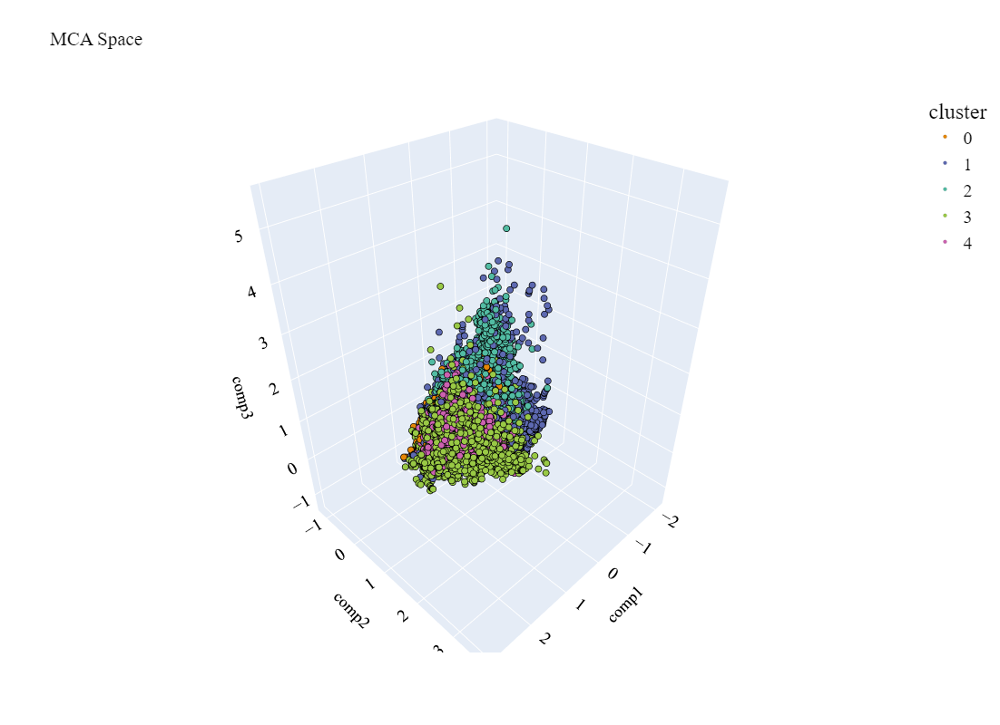

In [31]:
plot_pca_3d(mca_3d_df, title="MCA Space", opacity=1, width_line = 0.1)

In [32]:
mca_2d, mca_2d_df = get_MCA_2d(df_no_outliers_norm, clusters)

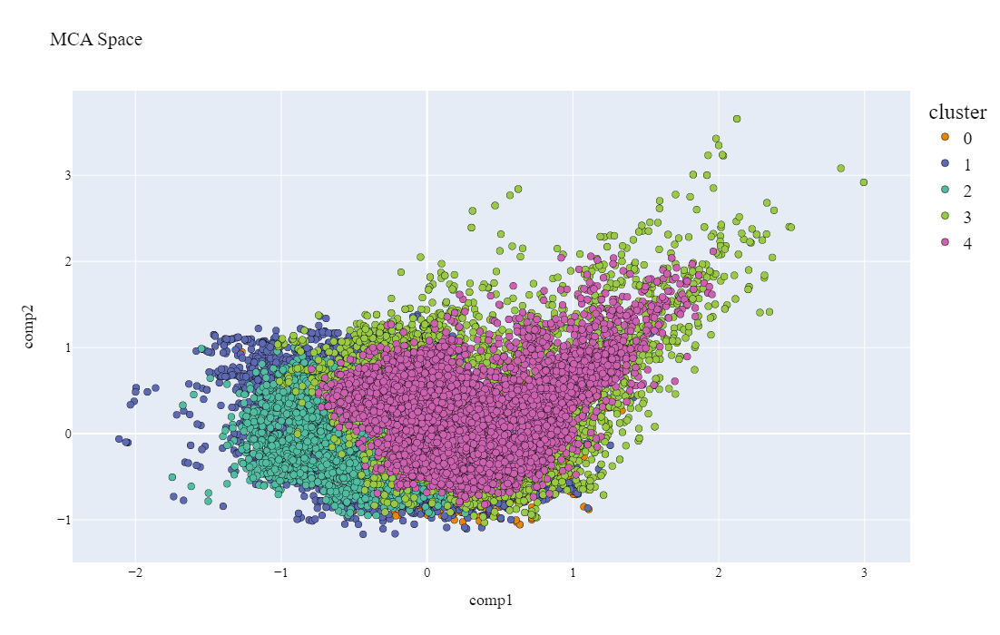

In [33]:
plot_pca_2d(mca_2d_df, title="MCA Space", opacity=1, width_line = 0.5)

<h1> We can obtain the components of the PCA analysis and represent the identified clusters by the kprototype algorithm
</h1>

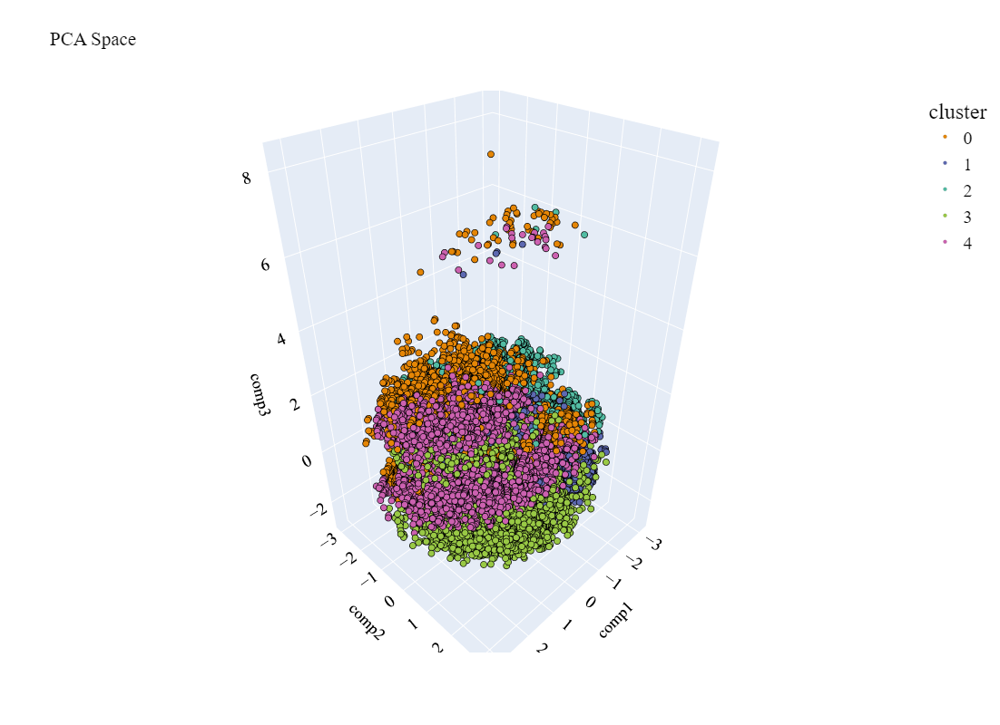

The variability is :           eigenvalue % of variance % of variance (cumulative)
component                                                    
0              1.493        18.66%                     18.66%
1              1.322        16.53%                     35.19%
2              1.055        13.18%                     48.37%


In [34]:
pca_3d_object, df_pca_3d = get_pca_3d(data_no_outliers, clusters)
plot_pca_3d(df_pca_3d, title = "PCA Space", opacity=1, width_line = 0.1)
print("The variability is :", pca_3d_object.eigenvalues_summary)

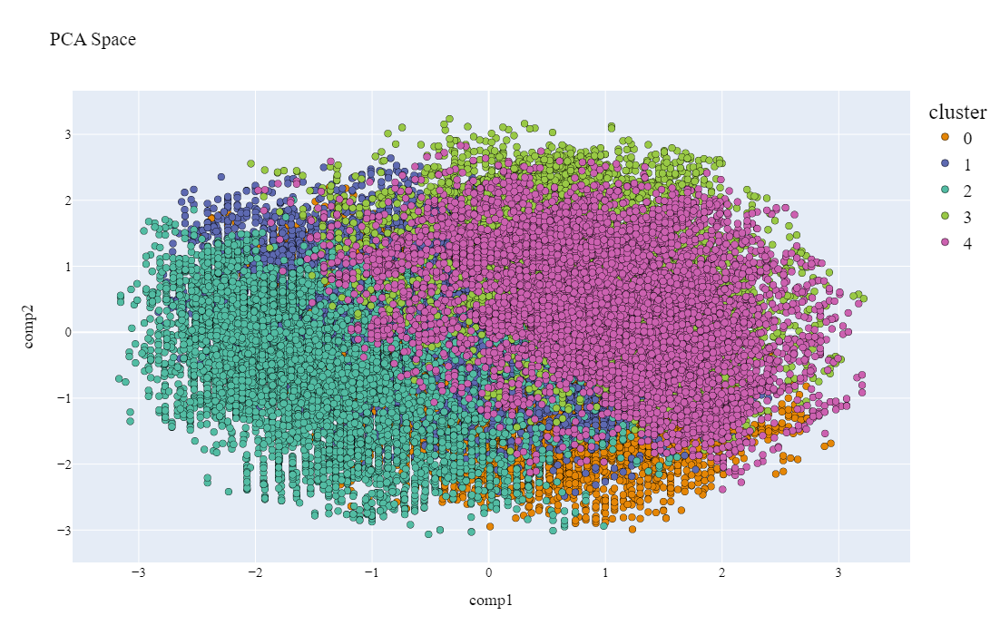

In [35]:
pca_2d_object, df_pca_2d = get_pca_2d(data_no_outliers, clusters)
plot_pca_2d(df_pca_2d, title = "PCA Space", opacity=1, width_line = 0.5)


<h1> Features importance </h1>

[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001407 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 346
[LightGBM] [Info] Number of data points in the train set: 40691, number of used features: 8
[LightGBM] [Info] Start training from score -1.288309
[LightGBM] [Info] Start training from score -1.737218
[LightGBM] [Info] Start training from score -1.627316
[LightGBM] [Info] Start training from score -1.949529
[LightGBM] [Info] Start training from score -1.563239
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


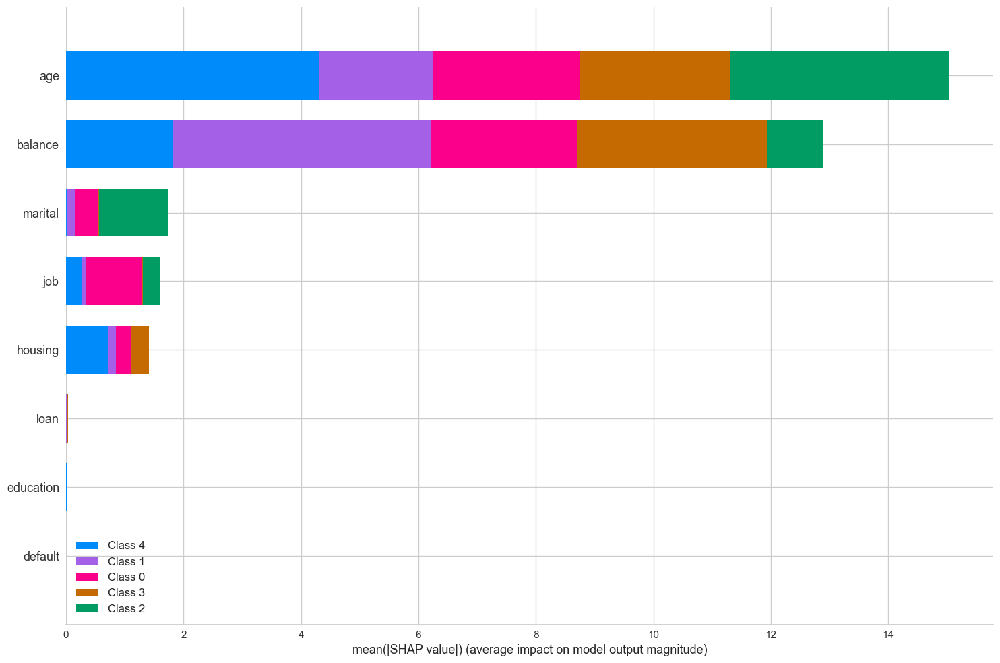

In [36]:
import lightgbm as lgb
import shap


clf_km = lgb.LGBMClassifier(colsample_by_tree=0.8)



for col in ["job", "marital", "education", "housing", "loan", "default"]:
    df_no_outliers_norm[col] = df_no_outliers_norm[col].astype('category')


clf_km.fit(X = df_no_outliers_norm , y = clusters, feature_name = "auto", categorical_feature = "auto")
# clf_km.fit(X = df_prueba, y = predict_embedding, feature_name='auto', categorical_feature = 'auto')
#SHAP values
explainer_km = shap.TreeExplainer(clf_km)
shap_values_km = explainer_km.shap_values(df_no_outliers_norm)
shap.summary_plot(shap_values_km, df_no_outliers_norm, plot_type="bar", plot_size=(15, 10))

In [37]:
df_no_outliers = df[df.outliers == 0]
df_no_outliers["cluster"] = clusters

df_no_outliers.groupby('cluster').agg(
    {
         'age':'mean',
        'balance': 'mean',
       
        'job': lambda x: x.value_counts().index[0],
        'marital': lambda x: x.value_counts().index[0],
        'education': lambda x: x.value_counts().index[0],
        'housing': lambda x: x.value_counts().index[0],
        'loan': lambda x: x.value_counts().index[0],
        'default': lambda x: x.value_counts().index[0],
        
    }
).sort_values("balance").reset_index()

C:\Users\hp\AppData\Local\Temp\ipykernel_13612\2279410345.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,cluster,age,balance,job,marital,education,housing,loan,default
0,0,38.017558,176.943316,blue-collar,married,secondary,yes,no,no
1,4,51.554500,302.270679,management,married,secondary,no,no,no
2,2,29.730673,391.930198,management,single,secondary,yes,no,no
3,1,35.107512,3089.760262,management,married,secondary,yes,no,no
4,3,51.142783,3101.546961,management,married,secondary,no,no,no
